<a href="https://colab.research.google.com/github/Surajpatra700/OpenCV/blob/main/OpenCV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone https://github.com/misbah4064/opencvTutorial.git
%cd opencvTutorial/
from IPython.display import clear_output
clear_output()

## **1. OpenCV Basics**

*Lesson 1. Changing Image's Color Profile*

In [2]:
import cv2
from google.colab.patches import cv2_imshow

# Colorful img - 3 channel
image = cv2.imread("/content/opencvTutorial/images/color.jpg")
# cv2_imshow(image)
print(image.shape)

# grayscale image
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
# cv2_imshow(gray)
print(gray.shape)

# HSV Image
HSV = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
print(HSV.shape)

(476, 640, 3)
(476, 640)
(476, 640, 3)


*For displaying Image from Internet*

Image read successfully!


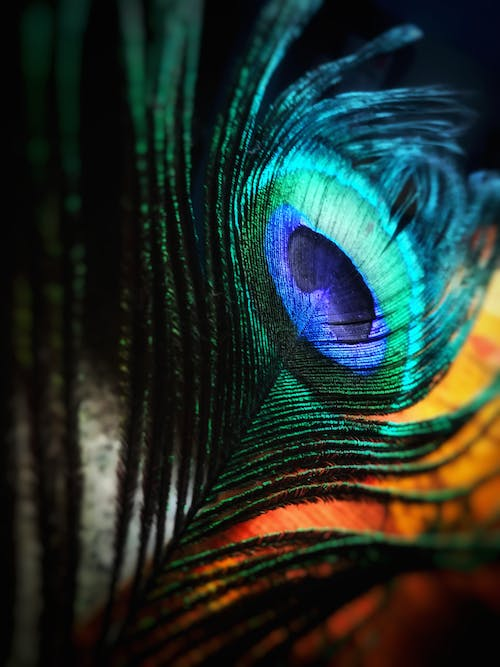

In [3]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
import requests

# cv2_imshow is specific to Colab for displaying images
image_url = "https://images.pexels.com/photos/674010/pexels-photo-674010.jpeg?auto=compress&cs=tinysrgb&dpr=1&w=500"

response = requests.get(image_url)
image_data = response.content

image = cv2.imdecode(np.frombuffer(image_data, np.uint8), cv2.IMREAD_COLOR)

if image is None:
    print("Error reading image!")
else:
    print("Image read successfully!")
    cv2_imshow(image)

*Lesson 2: Edge Detection*

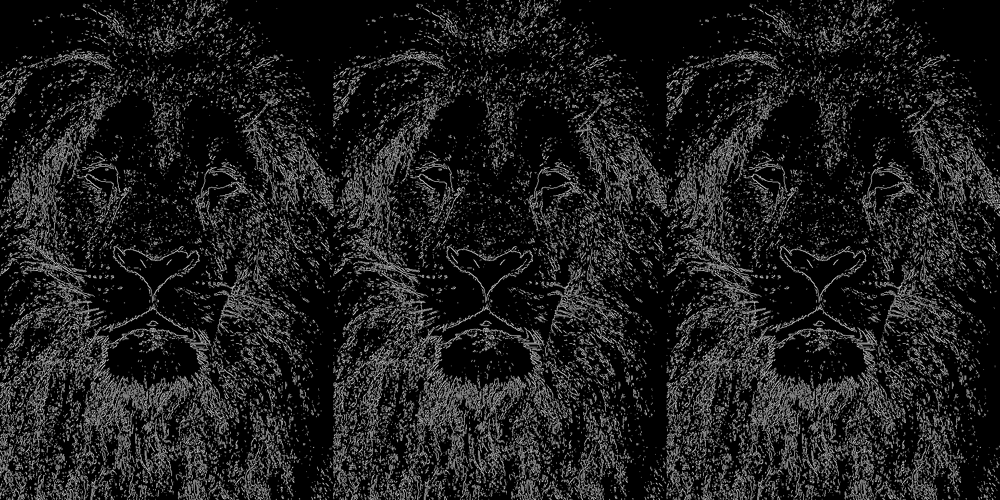

In [4]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

img = cv2.imread("/content/opencvTutorial/images/lion.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

canny_img = cv2.Canny(gray,200,200) # canny image is the edge detected img that only works on grayscale img
# cv2_imshow(canny_img)

# erosion & dilation

kernel = np.ones((1,1), np.uint8)
# erosion --> removing noise from the grayscale image
# dilation --> opposite of erosion

# erosion
erode_img = cv2.erode(canny_img, kernel, iterations=1);
# cv2_imshow(erode_img)

# dilation
dilate_img = cv2.dilate(erode_img,kernel,iterations=1)

display = np.hstack((canny_img, dilate_img, erode_img)) # hstack helps to load images in horizontal fashion
cv2_imshow(display)

*Lesson 3: Image manipulation*

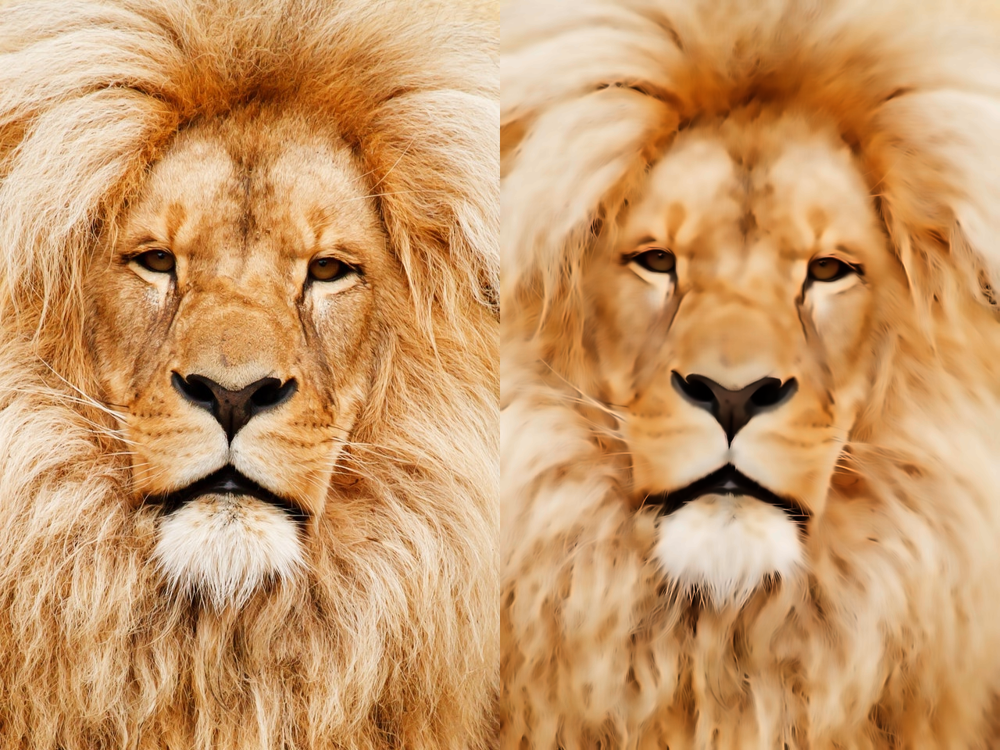

In [5]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

img = cv2.imread("images/lion.jpg")

dst = cv2.fastNlMeansDenoisingColored(img, None, 20,20,7,15)

display = np.hstack((img, dst))
cv2_imshow(display)

*Lesson 4: Drawing Shapes and Writting Text on Images*

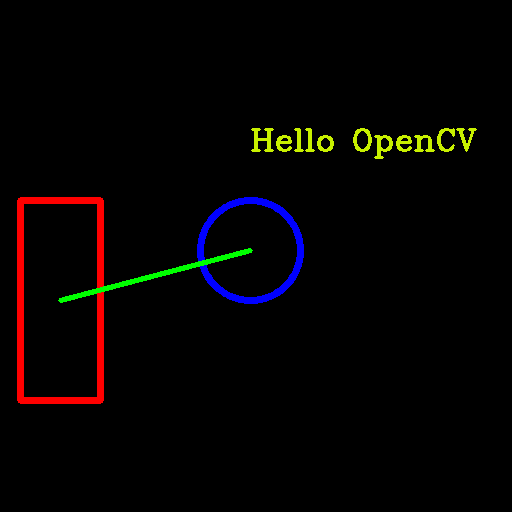

In [6]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

img = np.zeros((512,512,3),np.uint8) # In CV 0 means black color
# uint8: 0 to 255

# Drawing Function
# Drawing Circle
cv2.circle(img, (250,250), 50, (255,0,0), 5)
# Drawing Rectangle
cv2.rectangle(img, (20, 400), (100,200), (0,0,255), 5) # pt1--> top left corner cordinates & pt2 --> bottom right corner cordinates
# Drawing a line
cv2.line(img, (60,300), (250,250), (0,255,0), 4)
# Write a text
cv2.putText(img,"Hello OpenCV",(250,150), cv2.FONT_HERSHEY_COMPLEX,1,(0,240,200),2)
cv2_imshow(img)

**2. Intermediate Exercises**

*Lesson 1: Color Detection*

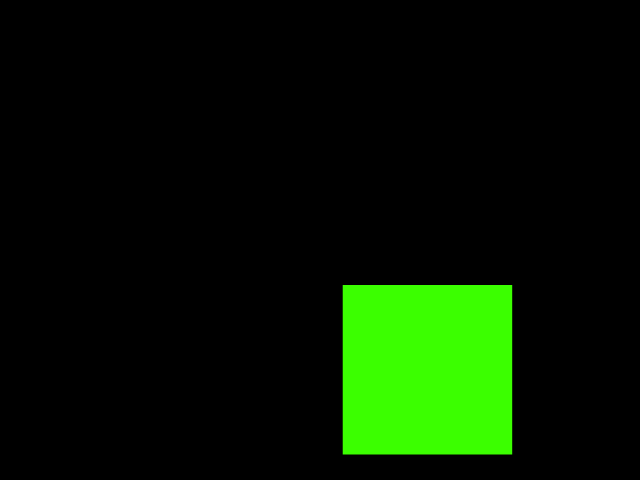

In [7]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

img = cv2.imread("/content/opencvTutorial/images/shapes.png");
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# Extracting blue color
# lower_hue = np.array([65,0,0])
# higher_hue = np.array([110,255,255])

# Extracting red color
# lower_hue = np.array([0,0,0]) # first 0 = hue, second 0 = saturation, 3rd 0 = variance of (hsv)
# higher_hue = np.array([20,255,255])

# Extracting Green Color
lower_hue = np.array([46,0,0]) # first 46 = hue, second 0 = saturation, 3rd 0 = variance of (hsv)
higher_hue = np.array([91,255,255])

mask = cv2.inRange(hsv,lower_hue,higher_hue) # Helps to mask out that img which has that particular range value in lower_hue and higher_hue
result = cv2.bitwise_and(img, img, mask=mask)
cv2_imshow(result)

***Lesson 2: Face Detection***

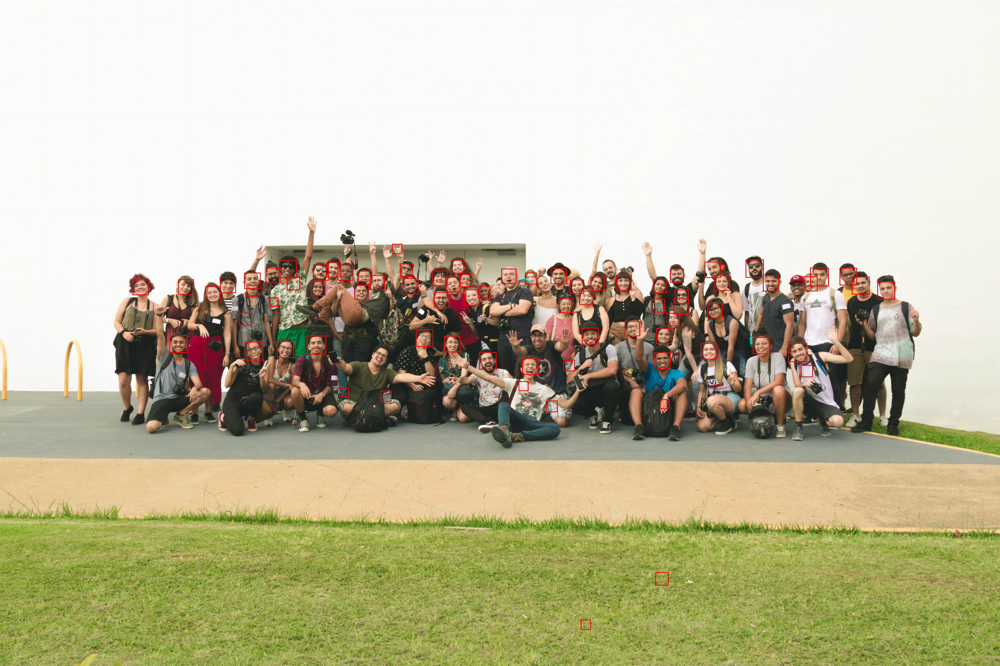

In [8]:
import cv2
from google.colab.patches import cv2_imshow

face_cascade = cv2.CascadeClassifier("/content/opencvTutorial/files/haarcascade_frontalface_default.xml") # CascadeClassifier is a pretrained ML model algo that helps to detect faces, eyes, smiles in an image or video
img = cv2.imread("/content/opencvTutorial/images/group.jpg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
faces = face_cascade.detectMultiScale(gray,1.1,minNeighbors=5)

for(x,y,w,h) in faces: # faces contains 4 cordinates x & y top left cordinates of the face and w & h as width and height of the face
  cv2.rectangle(img,(x,y),(x+w,y+h),(0,0,255),3)

cv2_imshow(img)

***Lesson 3: Shape Detection***

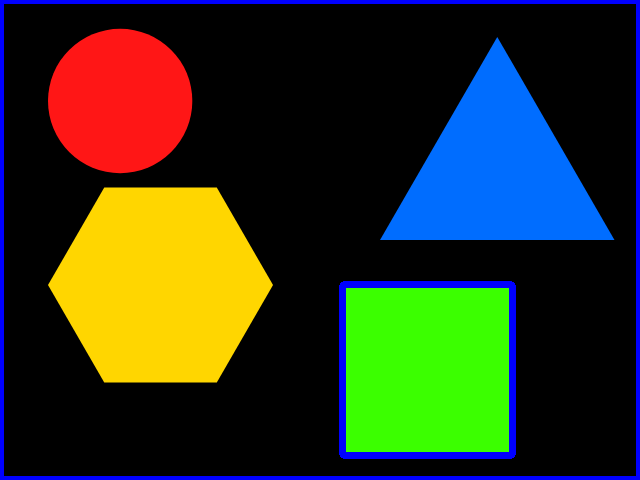

In [12]:
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/opencvTutorial/images/shapes.png")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

res, thres = cv2.threshold(gray,50,255,1) # threshold is required to extract the image/object with threshold value betwn 50-255 range in gray scale img
# cv2_imshow(thres)

contours, history = cv2.findContours(thres,1,2) # helps to find contours/points that are responsible for drawing boundaries around any shape
for cnt in contours:
  approx = cv2.approxPolyDP(cnt, 0.01*cv2.arcLength(cnt,True), True) # approximates the amt of points required to specify the boundary of any shape
  n = len(approx)
  if n == 4:
    cv2.drawContours(img, [cnt], 0, 255, 5)

cv2_imshow(img)

# ***Project 1: Tracking a ball***